Epoch [1/1000]  Loss_D: 1.0128  Loss_G: 5.4088
Epoch [2/1000]  Loss_D: 0.6382  Loss_G: 7.1139
Epoch [3/1000]  Loss_D: 0.7870  Loss_G: 14.0282
Epoch [4/1000]  Loss_D: 1.3250  Loss_G: 14.5462
Epoch [5/1000]  Loss_D: 0.4923  Loss_G: 10.1212
Epoch [6/1000]  Loss_D: 0.6214  Loss_G: 12.4772
Epoch [7/1000]  Loss_D: 0.7003  Loss_G: 17.3069
Epoch [8/1000]  Loss_D: 0.4858  Loss_G: 10.9417
Epoch [9/1000]  Loss_D: 0.3975  Loss_G: 8.6492
Epoch [10/1000]  Loss_D: 0.3703  Loss_G: 7.2511
Epoch [11/1000]  Loss_D: 0.3818  Loss_G: 7.3044
Epoch [12/1000]  Loss_D: 0.3642  Loss_G: 7.1153
Epoch [13/1000]  Loss_D: 0.4090  Loss_G: 9.1419
Epoch [14/1000]  Loss_D: 0.4506  Loss_G: 8.0862
Epoch [15/1000]  Loss_D: 0.3602  Loss_G: 7.4046
Epoch [16/1000]  Loss_D: 0.3609  Loss_G: 6.7783
Epoch [17/1000]  Loss_D: 0.3640  Loss_G: 9.3110
Epoch [18/1000]  Loss_D: 0.3614  Loss_G: 7.0317
Epoch [19/1000]  Loss_D: 0.3795  Loss_G: 8.7485
Epoch [20/1000]  Loss_D: 0.4080  Loss_G: 7.1990
Epoch [21/1000]  Loss_D: 2.1990  Loss_G: 15

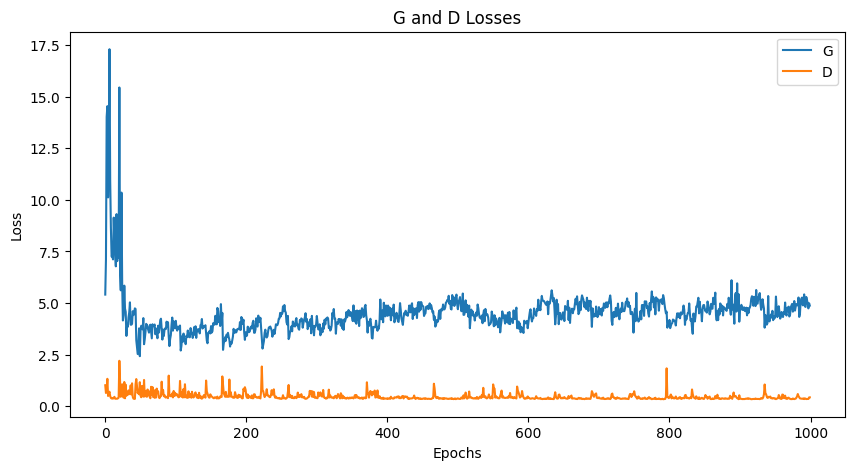

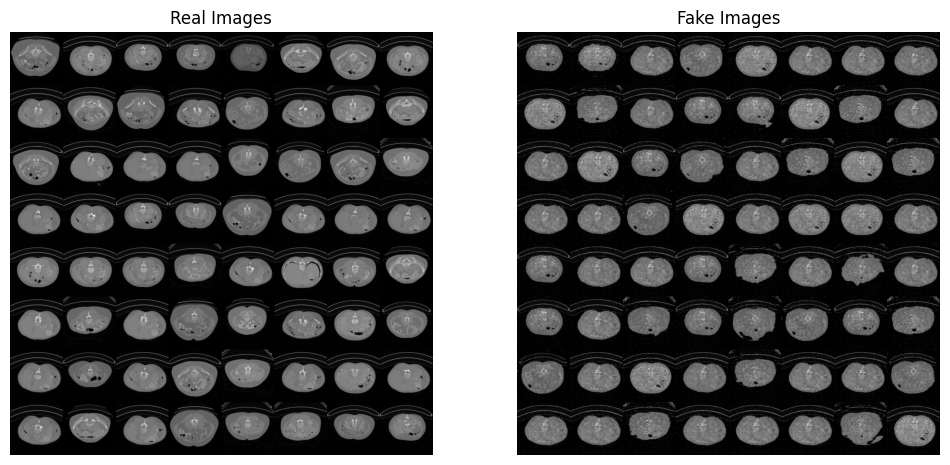

In [1]:
import torch
import torch.nn as nn
import torch.optim as optim
import torchvision.transforms as transforms
import os
from torch.utils.data import DataLoader, Dataset
from PIL import Image
import numpy as np
import matplotlib.pyplot as plt
import torchvision.utils as vutils

# Custom dataset class for grayscale medical images
class MedicalImagesDataset(Dataset):
    def __init__(self, root_dir, transform=None):
        self.root_dir = root_dir
        self.transform = transform
        self.image_paths = [
            os.path.join(root_dir, fname)
            for fname in os.listdir(root_dir)
            if fname.lower().endswith(('.jpg', '.png', '.jpeg'))
        ]
        if len(self.image_paths) == 0:
            raise RuntimeError("No image files found in {}".format(root_dir))

    def __len__(self):
        return len(self.image_paths)

    def __getitem__(self, idx):
        img_path = self.image_paths[idx]
        img = Image.open(img_path).convert('L')
        if self.transform:
            img = self.transform(img)
        return img

# Parameters

# Data
dataroot = "/kaggle/input/images-medical-jpg/image_medical"
batch_size = 64
image_size = 256  # changed to 256
nc = 1            # grayscale channels
tz = 100         # latent vector size
ngf = 32         # generator feature map size multiplier
df = 32         # discriminator feature map size multiplier
num_epochs = 1000
lr = 0.0002
beta1 = 0.5

# Transform
transform = transforms.Compose([
    transforms.Resize(image_size),
    transforms.CenterCrop(image_size),
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,)),
])

# Dataset & Dataloader
dataset = MedicalImagesDataset(root_dir=dataroot, transform=transform)
dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=True, num_workers=2)

def weights_init(m):
    classname = m.__class__.__name__
    if 'Conv' in classname:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif 'BatchNorm' in classname:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

# Generator: from latent tz to 256x256
class Generator(nn.Module):
    def __init__(self, ngf, tz, nc):
        super(Generator, self).__init__()
        self.main = nn.Sequential(
            # Input is Z, going into a convolution
            nn.ConvTranspose2d(tz, ngf * 16, 4, 1, 0, bias=False),  # 1x1 -> 4x4
            nn.BatchNorm2d(ngf * 16),
            nn.ReLU(True),
            # State size: (ngf*16) x 4 x 4
            nn.ConvTranspose2d(ngf * 16, ngf * 8, 4, 2, 1, bias=False), # 4->8
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),
            # State size: (ngf*8) x 8 x 8
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),  # 8->16
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            # State size: (ngf*4) x 16 x 16
            nn.ConvTranspose2d(ngf * 4, ngf * 2, 4, 2, 1, bias=False),  # 16->32
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            # State size: (ngf*2) x 32 x 32
            nn.ConvTranspose2d(ngf * 2, ngf, 4, 2, 1, bias=False),      # 32->64
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            # State size: (ngf) x 64 x 64
            nn.ConvTranspose2d(ngf, ngf // 2, 4, 2, 1, bias=False),    # 64->128
            nn.BatchNorm2d(ngf // 2),
            nn.ReLU(True),
            # State size: (ngf//2) x 128 x 128
            nn.ConvTranspose2d(ngf // 2, nc, 4, 2, 1, bias=False),     # 128->256
            nn.Tanh()
            # Output size: nc x 256 x 256
        )

    def forward(self, input):
        return self.main(input)

# Discriminator: from 256x256 to scalar
class Discriminator(nn.Module):
    def __init__(self, df, nc):
        super(Discriminator, self).__init__()
        self.main = nn.Sequential(
            # Input: nc x 256 x 256
            nn.Conv2d(nc, df//2, 4, 2, 1, bias=False),       # 256->128
            nn.LeakyReLU(0.2, inplace=True),
            # State: (df//2) x128 x128
            nn.Conv2d(df//2, df, 4, 2, 1, bias=False),       # 128->64
            nn.BatchNorm2d(df),
            nn.LeakyReLU(0.2, inplace=True),
            # (df) x64 x64
            nn.Conv2d(df, df*2, 4, 2, 1, bias=False),        # 64->32
            nn.BatchNorm2d(df*2),
            nn.LeakyReLU(0.2, inplace=True),
            # (df*2) x32 x32
            nn.Conv2d(df*2, df*4, 4, 2, 1, bias=False),      # 32->16
            nn.BatchNorm2d(df*4),
            nn.LeakyReLU(0.2, inplace=True),
            # (df*4) x16 x16
            nn.Conv2d(df*4, df*8, 4, 2, 1, bias=False),      # 16->8
            nn.BatchNorm2d(df*8),
            nn.LeakyReLU(0.2, inplace=True),
            # (df*8) x8 x8
            nn.Conv2d(df*8, df*16, 4, 2, 1, bias=False),     # 8->4
            nn.BatchNorm2d(df*16),
            nn.LeakyReLU(0.2, inplace=True),
            # (df*16)x4x4 -> final conv
            nn.Conv2d(df*16, 1, 4, 1, 0, bias=False),        # 4->1
        )

    def forward(self, input):
        return self.main(input).view(-1)

# Device
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Initialize networks
netG = Generator(ngf, tz, nc).to(device)
netD = Discriminator(df, nc).to(device)
netG.apply(weights_init)
netD.apply(weights_init)

# Loss and optimizers
criterion = nn.BCEWithLogitsLoss()
optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

# Labels and noise
real_label = 0.9
fake_label = 0.0
fixed_noise = torch.randn(64, tz, 1, 1, device=device)

# Training loop
G_losses = []
D_losses = []
img_list = []

for epoch in range(num_epochs):
    runningD = 0.0
    runningG = 0.0
    for i, data in enumerate(dataloader, 0):
        # Train Discriminator
        netD.zero_grad()
        real = data.to(device)
        real += 0.05 * torch.randn_like(real)
        b_size = real.size(0)
        label = torch.full((b_size,), real_label, device=device)

        out_real = netD(real)
        errD_real = criterion(out_real, label)
        errD_real.backward()

        noise = torch.randn(b_size, tz, 1, 1, device=device)
        fake = netG(noise)
        label.fill_(fake_label)
        out_fake = netD(fake.detach())
        errD_fake = criterion(out_fake, label)
        errD_fake.backward()
        optimizerD.step()

        # Train Generator
        netG.zero_grad()
        label.fill_(real_label)
        out2 = netD(fake)
        errG = criterion(out2, label)
        errG.backward()
        optimizerG.step()

        runningD += (errD_real + errD_fake).item()
        runningG += errG.item()

    G_losses.append(runningG / len(dataloader))
    D_losses.append(runningD / len(dataloader))

    print(f"Epoch [{epoch+1}/{num_epochs}]  Loss_D: {runningD/len(dataloader):.4f}  Loss_G: {runningG/len(dataloader):.4f}")

    if (epoch + 1) % 10 == 0:
        with torch.no_grad():
            fake = netG(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))
            vutils.save_image(fake, f"output_epoch_{epoch+1}.png", normalize=True)

# Plot losses
plt.figure(figsize=(10,5))
plt.title("G and D Losses")
plt.plot(G_losses, label="G")
plt.plot(D_losses, label="D")
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.legend()
plt.show()

# Display real vs fake
real_batch = next(iter(dataloader))
plt.figure(figsize=(12,6))
plt.subplot(1,2,1)
plt.axis('off')
plt.title('Real Images')
plt.imshow(np.transpose(vutils.make_grid(real_batch[:64], padding=2, normalize=True), (1,2,0)), cmap='gray')
plt.subplot(1,2,2)
plt.axis('off')
plt.title('Fake Images')
plt.imshow(np.transpose(img_list[-1], (1,2,0)), cmap='gray')
plt.show()


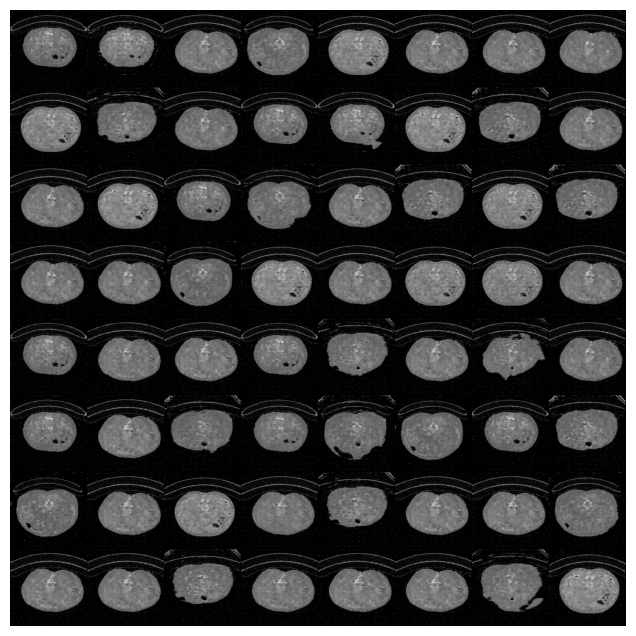

In [2]:

import torch

import torch.nn as nn
import torch.optim as optim
import torchvision.transforms as transforms
import os
from torch.utils.data import DataLoader
from PIL import Image
from torch.utils.data import Dataset
import numpy as np
import matplotlib.pyplot as plt
import torchvision.utils as vutils
from IPython.display import HTML

import shutil  # Import shutil for zipping
import matplotlib.animation as animation

fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

In [3]:
import shutil
output_root = '/kaggle/working/'
shutil.make_archive(f"{output_root}images_generated", 'zip', output_root)

'/kaggle/working/images_generated.zip'

In [4]:
#  Epoch 49/50 => Loss_D: 0.06447744103414672 Loss_G: 5.318968227931431
# Epoch 99/100 => Loss_D: 0.11371721007994243 Loss_G: 4.984694276537214
#Epoch 149/150 => Loss_D: 0.32426102246556965 Loss_G: 4.26883772441319
#Epoch 249/250 => Loss_D: 0.03673938049801758 Loss_G: 4.9730095863342285
#Epoch 199/200 => Loss_D: 0.032346553834421296 Loss_G: 5.241856234414237